# zero
学習用期間に購入履歴がないユーザーをどうするか

基本的にユーザーの特徴はageしかないので、ageごとに人気商品を分ける

In [55]:
import datetime

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from tqdm.auto import tqdm
import datetime

import numpy as np
import pandas as pd
from logzero import logger
from metric import mapk, apk
from scipy import sparse
from tqdm import tqdm
from utils import train_valid_split, plot_images

import schema

In [56]:
transactions = pd.read_pickle('./input/transformed/transactions_train.pkl')[['t_dat', 'user', 'item']]
users = pd.read_pickle('./input/transformed/users.pkl')[schema.USERS]
items = pd.read_pickle('./input/transformed/items.pkl')[schema.ITEMS]
n_user = len(users)
n_item = len(items)
TOPK = 12

In [57]:
# train: 3 weeks を基準とする
valid_start_date = datetime.date(2020, 9, 16)
transactions_train_fixed, transactions_valid = train_valid_split(transactions, valid_start_date, 21)
transactions_train, _ = train_valid_split(transactions, valid_start_date, 7)  # 集計用の期間

[I 220310 21:11:36 utils:29] train: [2020-08-19, 2020-09-09)
[I 220310 21:11:37 utils:31] # of records: 804482
[I 220310 21:11:37 utils:16] valid: [2020-09-09, 2020-09-16)
[I 220310 21:11:37 utils:18] # of records: 255241
[I 220310 21:11:37 utils:29] train: [2020-09-02, 2020-09-09)
[I 220310 21:11:37 utils:31] # of records: 264657
[I 220310 21:11:37 utils:16] valid: [2020-09-09, 2020-09-16)
[I 220310 21:11:37 utils:18] # of records: 255241


In [58]:
users_valid = set(transactions_valid.user)
users_train = set(transactions_train_fixed.user)
users_zero = sorted(users_valid - users_train)
print(len(users_zero))
transactions_valid_zero = transactions_valid.query("user in @users_zero")
val = transactions_valid_zero.groupby('user')['item'].apply(list).reset_index()
val = val.merge(users[['user', 'age']], on='user')
val['age'] = val['age'].astype(str)

43982


In [59]:
transactions_train = transactions_train[['user', 'item']].drop_duplicates()

## 全体の人気商品

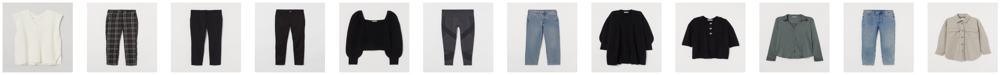

0.006247077544433413


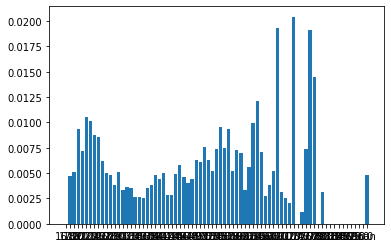

In [60]:
global_popular_items = transactions_train.groupby('item').size().reset_index(name='sz').sort_values(by='sz', ascending=False).item.values[:12]
plot_images(global_popular_items)
pred = val[['user', 'item', 'age']].reset_index(drop=True).rename(columns={'item': 'item_val'})
pred['item_pred'] = [global_popular_items] * len(pred)
pred['apk'] = [apk(a, b) for a, b in zip(pred['item_val'].values, pred['item_pred'].values)]
print(np.mean(pred['apk']))
gr1 = pred.groupby('age')['apk'].mean().reset_index()
plt.bar(gr1['age'].values, gr1['apk'].values);

## 頻繁に購入しているユーザーを除外(参考)

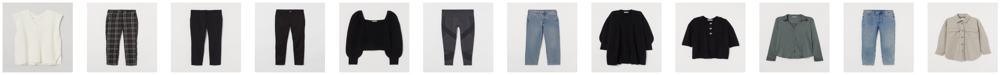

0.006291600721078807


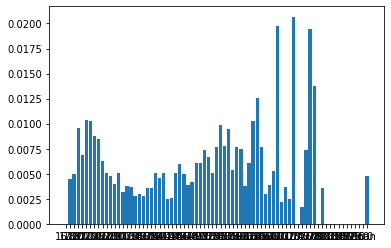

In [61]:
user_sz = transactions_train.groupby('user').size().reset_index(name='sz')
normal_users = user_sz[user_sz['sz'] < user_sz['sz'].quantile(0.9)].user.values
truncated_popular_items = transactions_train.query("user in @normal_users").groupby('item').size().reset_index(name='sz').sort_values(by='sz', ascending=False).item.values[:12]

plot_images(global_popular_items)
pred = val[['user', 'item', 'age']].reset_index(drop=True).rename(columns={'item': 'item_val'})
pred['item_pred'] = [truncated_popular_items] * len(pred)

pred['apk'] = [apk(a, b) for a, b in zip(pred['item_val'].values, pred['item_pred'].values)]
print(np.mean(pred['apk']))
gr = pred.groupby('age')['apk'].mean().reset_index()
plt.bar(gr['age'].values, gr['apk'].values);

## 年齢ごとにわける
なめらかになるように、各年齢に対して近い年齢のデータ取ってくる

16.0 25924


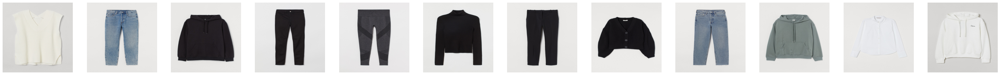

17.0 35062


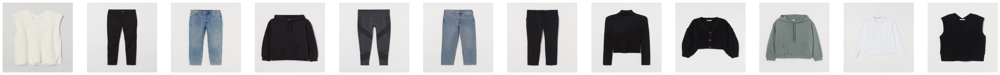

18.0 45565


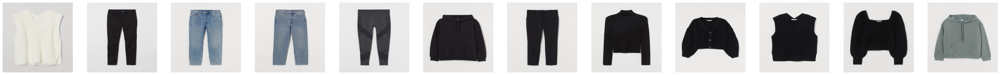

19.0 56932


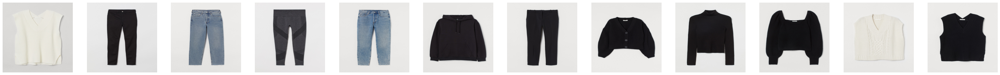

20.0 68831


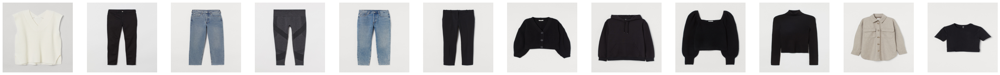

21.0 80087


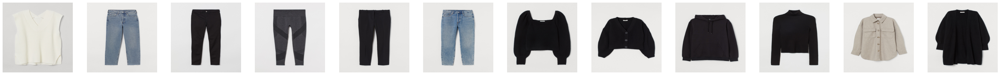

22.0 90672


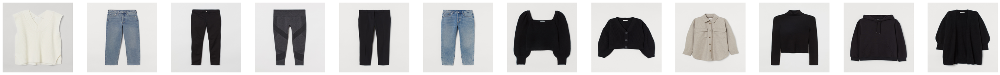

23.0 98599


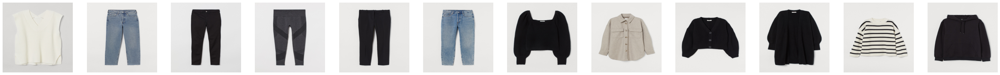

24.0 105177


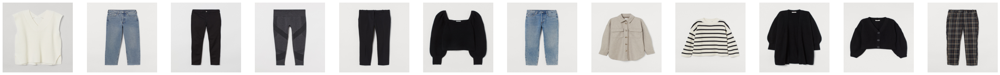

25.0 109075


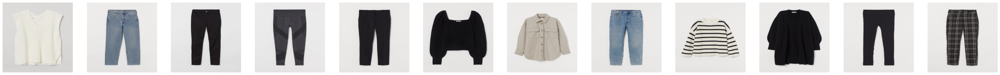

26.0 109060


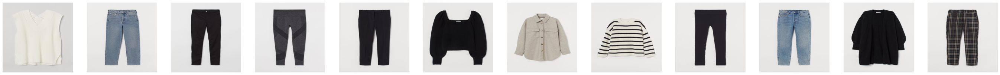

27.0 105076


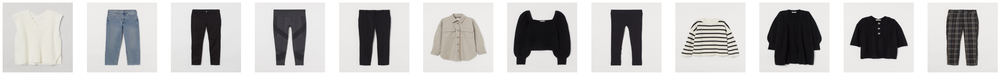

28.0 100709


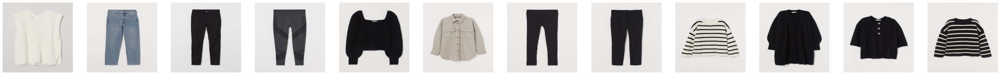

29.0 94259


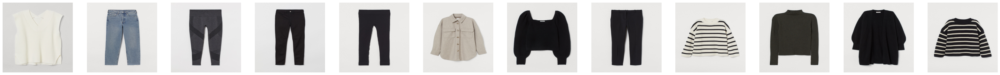

30.0 86605


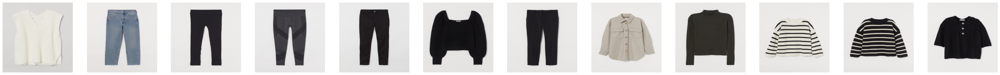

31.0 77791


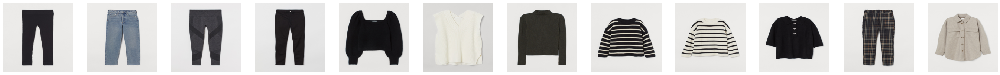

32.0 69140


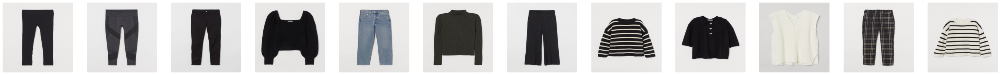

33.0 61307


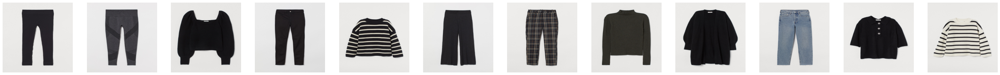

34.0 54173


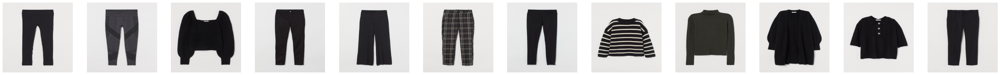

35.0 47729


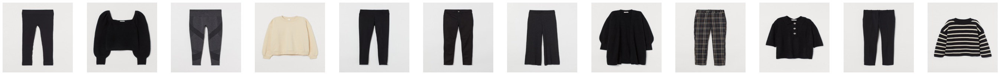

36.0 41878


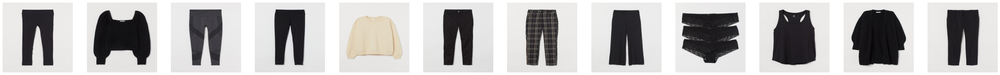

37.0 37125


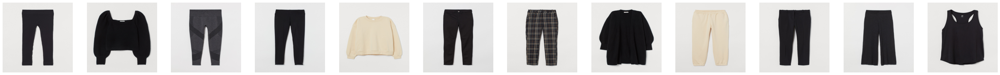

38.0 34150


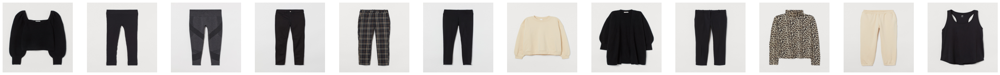

39.0 32466


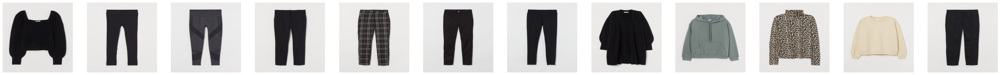

40.0 31944


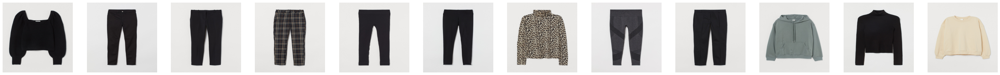

41.0 32161


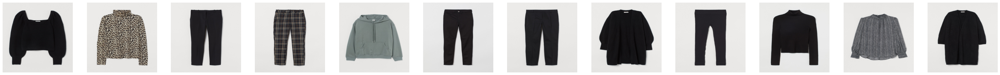

42.0 33325


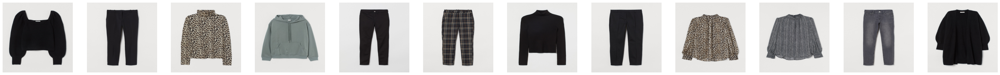

43.0 35411


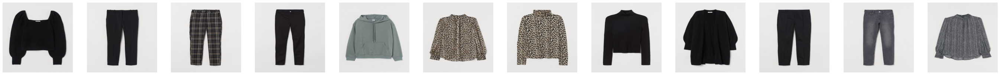

44.0 37732


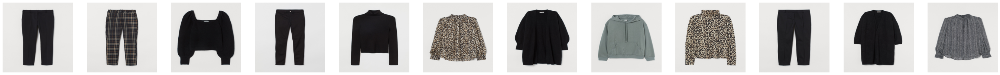

45.0 40476


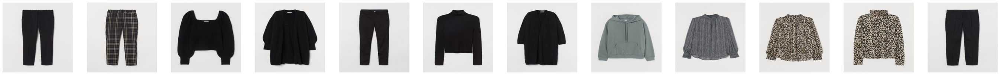

46.0 42661


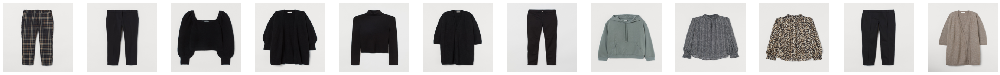

47.0 44665


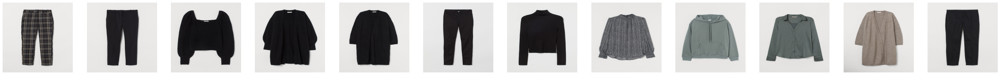

48.0 46083


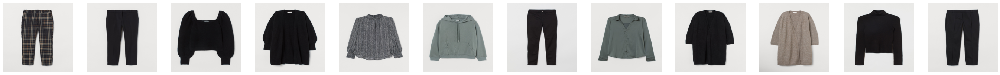

49.0 47112


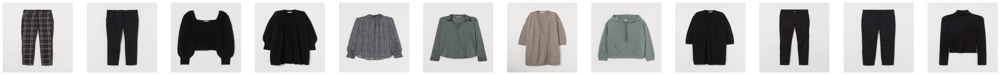

50.0 47493


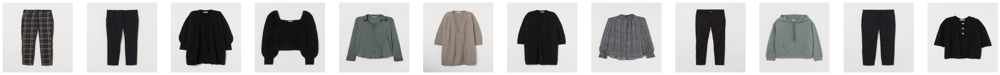

51.0 47144


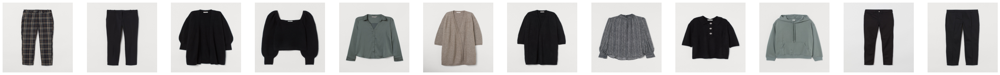

52.0 45968


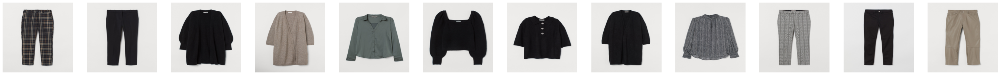

53.0 44135


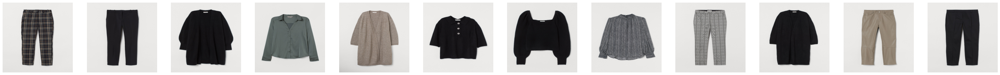

54.0 41433


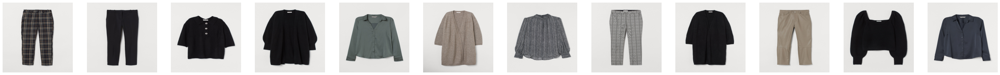

55.0 38082


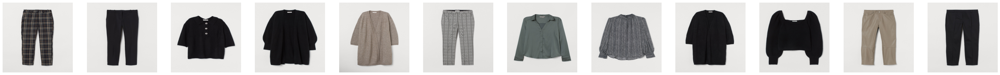

56.0 34604


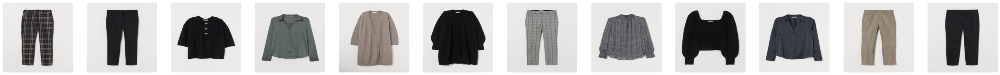

57.0 31157


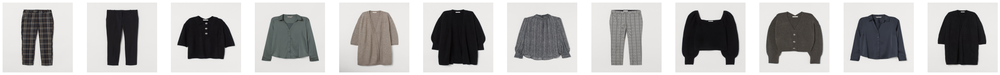

58.0 27355


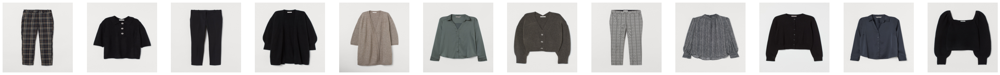

59.0 24071


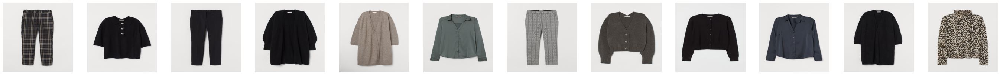

60.0 20930


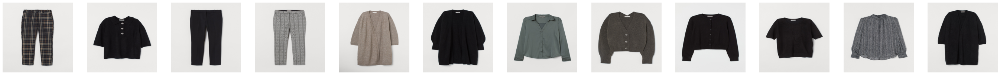

61.0 18115


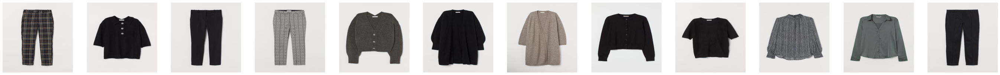

62.0 15503


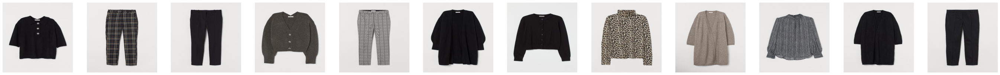

63.0 13238


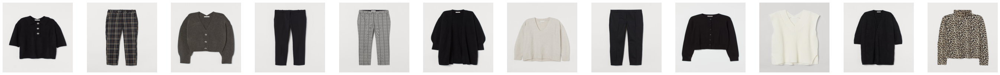

64.0 11226


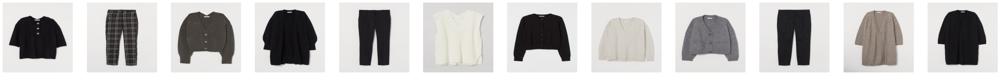

65.0 11097


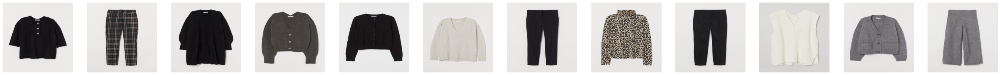

66.0 9336


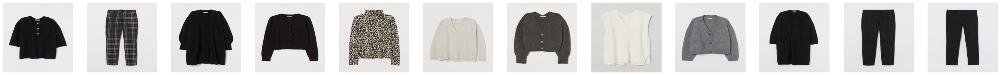

67.0 7821


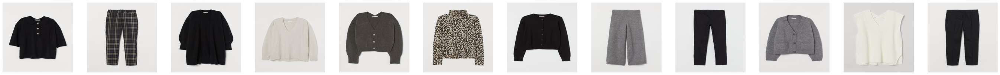

68.0 6479


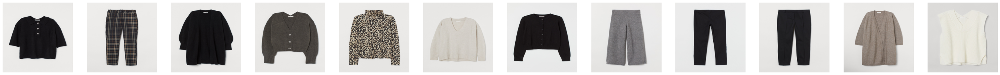

69.0 5520


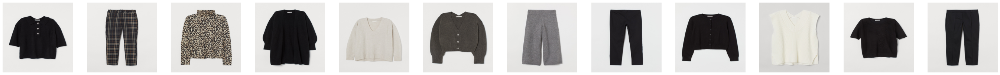

70.0 4619


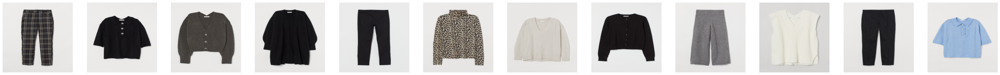

nan 4619


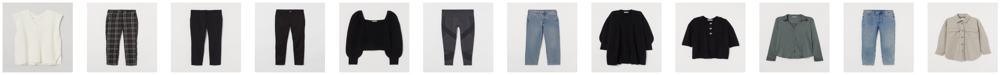

0.0071959911825274035


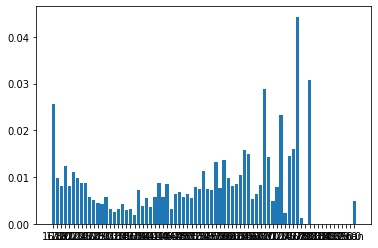

In [62]:
transactions_train_age = transactions_train.merge(users[['user', 'age']], on='user')
transactions_train_age['age'] = transactions_train_age['age'].clip(0.0, 70)

users['age_str'] = users['age'].clip(0, 70).astype(str)
ages = sorted(users['age_str'].unique())

results = []
for age in sorted(ages):
    if age == 'nan':
        b = global_popular_items
    else:
        lb = float(age) - 5
        ub = float(age) + 5
        a = transactions_train_age.query("@lb <= age <= @ub")
        b = a.groupby('item').size().reset_index(name='sz').sort_values(by='sz', ascending=False)['item'].values[:12]
    print(age, len(a))
    plot_images(b)
    results.append({
        'age_str': age,
        'item_pred': b,
    })
pop = pd.DataFrame(results)

pred = val[['user', 'item', 'age']].reset_index(drop=True).rename(columns={'item': 'item_val'})
pred = pred.merge(users[['user', 'age_str']], on='user').merge(pop, on='age_str')
pred['apk'] = [apk(a, b) for a, b in zip(pred['item_val'].values, pred['item_pred'].values)]
print(np.mean(pred['apk']))
gr2 = pred.groupby('age')['apk'].mean().reset_index()
plt.bar(gr2['age'].values, gr2['apk'].values);

<BarContainer object of 75 artists>

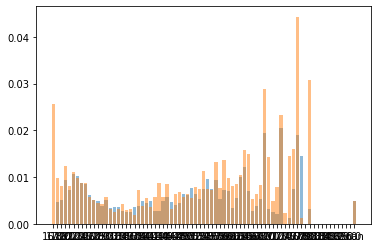

In [63]:
plt.bar(gr1.age, gr1.apk, alpha=0.5)
plt.bar(gr2.age, gr2.apk, alpha=0.5)

全体的に改善されていそう

## 精緻化
幅のとり方をもう少し機械的に計算する

In [64]:
transactions_train_age = transactions_train.merge(users[['user', 'age']])
transactions_train_age['age'] = transactions_train_age['age'].fillna(0).astype(int)
age_volume = transactions_train_age.groupby('age').size().reset_index(name='sz').sort_values(by='age')
sz_threshold = age_volume.query("24 <= age <= 26").sz.sum()  # 最もtransactionsのボリュームが大きい25歳で幅1を取ったときの数を基準とする
sz_threshold

34522

In [66]:
# 各ageに対して閾値を超える最小の幅を求める
age_width = {}
for age in range(10, 100):
    for d in range(1, 100):
        lb = age - d
        ub = age + d
        sz = age_volume.query("@lb <= age <= @ub").sz.sum()
        if sz >= sz_threshold:
            age_width[age] = d
            break

In [67]:
age_items = {}
for age in range(10, 100):
    lb = age - age_width[age]
    ub = age + age_width[age]
    age_items[age] = transactions_train_age.query("@lb <= age <= @ub").groupby('item').size().reset_index(name='sz').sort_values(by='sz', ascending=False)['item'].values[:12]

# age: nanには全体の人気商品を割り当てる
age_items[0] = transactions_train.groupby('item').size().reset_index(name='sz').sort_values(by='sz', ascending=False)['item'].values[:12]

In [68]:
age_pred = pd.DataFrame({
    'age': age_items.keys(),
    'item': age_items.values(),
})

0.007060475780156042


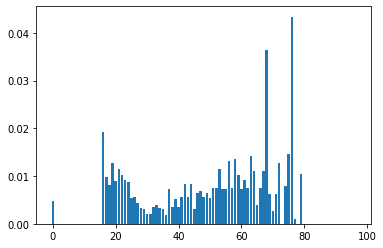

In [69]:
pred = val[['user', 'item']].rename(columns={'item': 'item_val'})
pred = pred.merge(users[['user', 'age']], on='user')
pred['age'] = pred['age'].fillna(0).astype(int)
pred = pred.merge(age_pred, on='age').rename(columns={'item': 'item_pred'})

pred['apk'] = [apk(a, b) for a, b in zip(pred['item_val'].values, pred['item_pred'].values)]
print(np.mean(pred['apk']))
gr2 = pred.groupby('age')['apk'].mean().reset_index()
plt.bar(gr2['age'].values, gr2['apk'].values);